In [24]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# from google.colab import drive
from pathlib import Path
from math import ceil

# drive.mount('/content/drive')

WORKING_DIR = "/content/drive/MyDrive/MS_by_Research/SEMESTER1/VISUAL_RECOGNITION/graded_assignment_1"

DATASET_DIR = f"{WORKING_DIR}/coin_dataset/"
RESULT_DIR = f"{WORKING_DIR}/part1_results/"

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:



def adaptive_gaussian_blur(image):
    '''Adaptive Gaussian Blur'''
    # Compute the Laplacian of the image and then return the variance
    laplacian_var = cv2.Laplacian(image, cv2.CV_64F).var()
    if laplacian_var > 80:
        ksize = (3, 3)
    elif laplacian_var > 40:
        ksize = (5, 5)
    else:
        ksize = (7, 7)
    return cv2.GaussianBlur(image, ksize, 0)

def adaptive_contrast(image):
    # Adaptive Histogram Equalization
    clahe = cv2.createCLAHE(clipLimit=1.5, tileGridSize=(8,8))
    return clahe.apply(image)

def adaptive_gamma(image):
    # Adaptive Gamma Correction
    mean_intensity = np.mean(image)
    gamma = np.log(0.5) / np.log(mean_intensity / 255.0)
    lookup_table = np.array([((i / 255.0) ** gamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(image, lookup_table)


def sobel_edge_detection(image):
    # Sobel Edge Detection
    blurred = adaptive_gaussian_blur(image)
    sobel_x = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3,borderType=cv2.BORDER_CONSTANT)
    sobel_y = cv2.Sobel(blurred, cv2.CV_64F, 0, 1, ksize=3,borderType=cv2.BORDER_CONSTANT)
    sobel_x = cv2.convertScaleAbs(sobel_x)
    sobel_y = cv2.convertScaleAbs(sobel_y)
    # Compute the gradient magnitude using Sobel edge detection
    sobel_magnitude = cv2.addWeighted(sobel_x, 0.5, sobel_y, 0.5, 0)
    return sobel_magnitude


def canny_edge_detection(image,sigma=0.8):
    # Canny Edge Detection
    blurred = adaptive_gaussian_blur(image)
    # Compute the median of the single channel pixel intens
    median_intensity = np.median(blurred)
    # Compute the lower and upper thresholds for the hysteresis process
    lower_threshold = int(max(0, (1.0 - sigma) * median_intensity))
    upper_threshold = int(min(255, (1.0 + sigma) * median_intensity))
    # Apply Canny edge detection
    edges = cv2.Canny(blurred, lower_threshold, upper_threshold)
    return edges

def prewitt_edge_detection(image):
    # Prewitt Edge Detection
    blurred = adaptive_gaussian_blur(image)
    prewitt_x = np.array([[1, 0, -1], [1, 0, -1], [1, 0, -1]])
    prewitt_y = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])
    prewitt_x_result = cv2.filter2D(image, -1, prewitt_x)
    prewitt_y_result = cv2.filter2D(image, -1, prewitt_y)
    prewitt_magnitude = np.sqrt(prewitt_x_result**2 + prewitt_y_result**2)
    return prewitt_magnitude










In [ ]:

def process_edges(image,image_name):
  # Load the image
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
  # Check if the image is blurry
  if cv2.Laplacian(image, cv2.CV_64F).var() < 20:
    gray = adaptive_contrast(gray)
  gray = adaptive_gamma(gray)

  # Apply adaptive Gaussian blur
  blurred = adaptive_gaussian_blur(gray)

  sobel_edges = sobel_edge_detection(gray)

  prewitt_edges = prewitt_edge_detection(gray)

  canny_edges = canny_edge_detection(gray)


  plt.figure(figsize=(20, 15))
  plt.subplot(2, 3, 1)
  plt.imshow(image)
  plt.title('Original Image')


  plt.subplot(2, 3, 2)
  plt.imshow(gray, cmap='gray')
  plt.title('Grayscale Image')

  plt.subplot(2, 3, 3)
  plt.imshow(blurred, cmap='gray')
  plt.title('Blurred Image')

  plt.subplot(2, 3, 4)
  plt.imshow(sobel_edges, cmap='gray')
  plt.title('Sobel Edges')

  plt.subplot(2, 3, 5)
  plt.imshow(prewitt_edges, cmap='gray')
  plt.title('Prewitt Edges')

  plt.subplot(2, 3, 6)
  plt.imshow(canny_edges, interpolation='gaussian',cmap='gray')
  plt.title('Canny Edges')

  plt.savefig(f'{RESULT_DIR}{image_name}_edges.png')
  plt.show()





In [ ]:
def segment_coins_contours(img):
    #Segmentation using Canny and contours

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    mean_intensity = np.mean(gray)

    # Invert the image if the mean intensity is greater than 127
    if mean_intensity > 127:
        gray = cv2.bitwise_not(gray)

    gray = adaptive_gaussian_blur(gray)

    # Apply Canny edge detection
    edges_contour = canny_edge_detection(gray)

    kernel = np.ones((3,3), np.uint8)

    # Dilate the edges
    edges_dilated_contour = cv2.dilate(edges_contour, kernel, iterations=3)

    # Find contours
    contours, _ = cv2.findContours(edges_dilated_contour, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    print(f"Number of contours: {len(contours)}")

    min_area = 10000
    segmented_coins = []
    coin_contours = []
    # Loop over the contours
    for contour in contours:
        area = cv2.contourArea(contour)
        if area < min_area:
            continue
        mask = np.zeros_like(gray)
        # Draw the contour on the mask for segmentation of each coin
        cv2.drawContours(mask, [contour], -1, 255, thickness=cv2.FILLED)
        segmented = cv2.bitwise_and(img, img, mask=mask)
        segmented_coins.append(segmented)
        coin_contours.append(contour)


    img_contour = img.copy()
    # Draw the contours on the image
    cv2.drawContours(img_contour, coin_contours, -1, (0, 255, 0), 8)

    return img_contour, segmented_coins


def count_coins(segmented_coins):
  # Count the number of coins
  return len(segmented_coins)







In [ ]:



def segment_coins_otsu(img):
    #Segmentation using Otsu's threshold

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


    gray = adaptive_gaussian_blur(gray)

    mean_intensity = np.mean(gray)
    # Invert the image if the mean intensity is greater than 127
    if mean_intensity > 127:
        threshold_type = cv2.THRESH_BINARY_INV
    else:
        threshold_type = cv2.THRESH_BINARY
    # Apply Otsu's thresholding
    _, binary = cv2.threshold(gray, 0, 255, threshold_type + cv2.THRESH_OTSU)
    plt.imshow(binary, cmap='gray')
    plt.title('Otsu Thresholding')
    plt.show()

    kernel = np.ones((3,3), np.uint8)
    # Morph
    binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=2)

    # Find contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)


    min_area = 10000
    segmented_coins = []
    coin_contours = []

    # Loop over the contours
    for contour in contours:
        area = cv2.contourArea(contour)
        if area < min_area:
            continue

        mask = np.zeros_like(gray)
        # Draw the contour on the mask for segmentation of each coin
        cv2.drawContours(mask, [contour], -1, 255, thickness=cv2.FILLED)

        segmented = cv2.bitwise_and(img, img, mask=mask)
        segmented_coins.append(segmented)
        coin_contours.append(contour)



    img_contour = img.copy()
    # Draw the contours on the image
    cv2.drawContours(img_contour, coin_contours, -1, (0, 255, 0), 3)

    return img_contour, segmented_coins

C_0.jpg


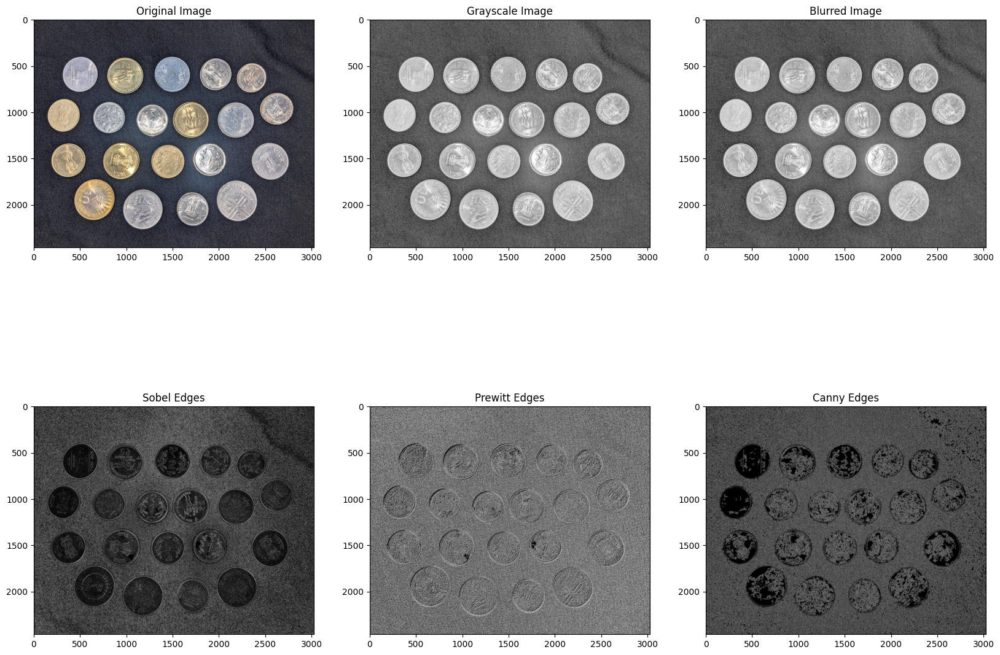

EDGE-BASED SEGMENTATION
Number of contours: 1


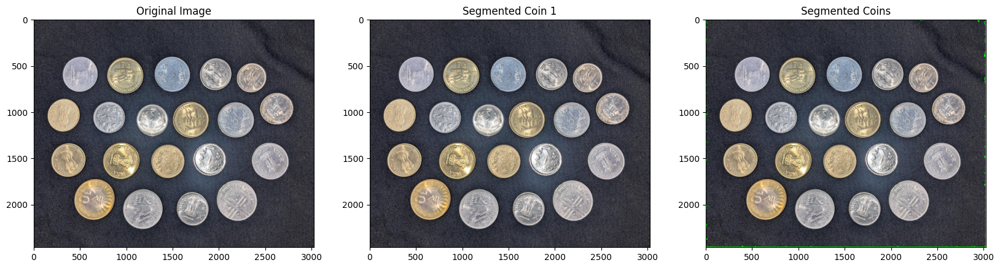

Number of coins: 1
REGION-BASED SEGMENTATION


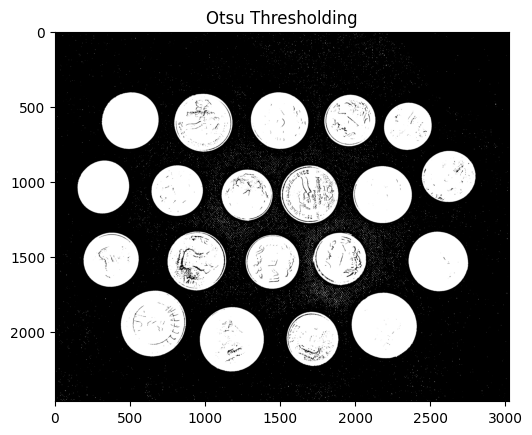

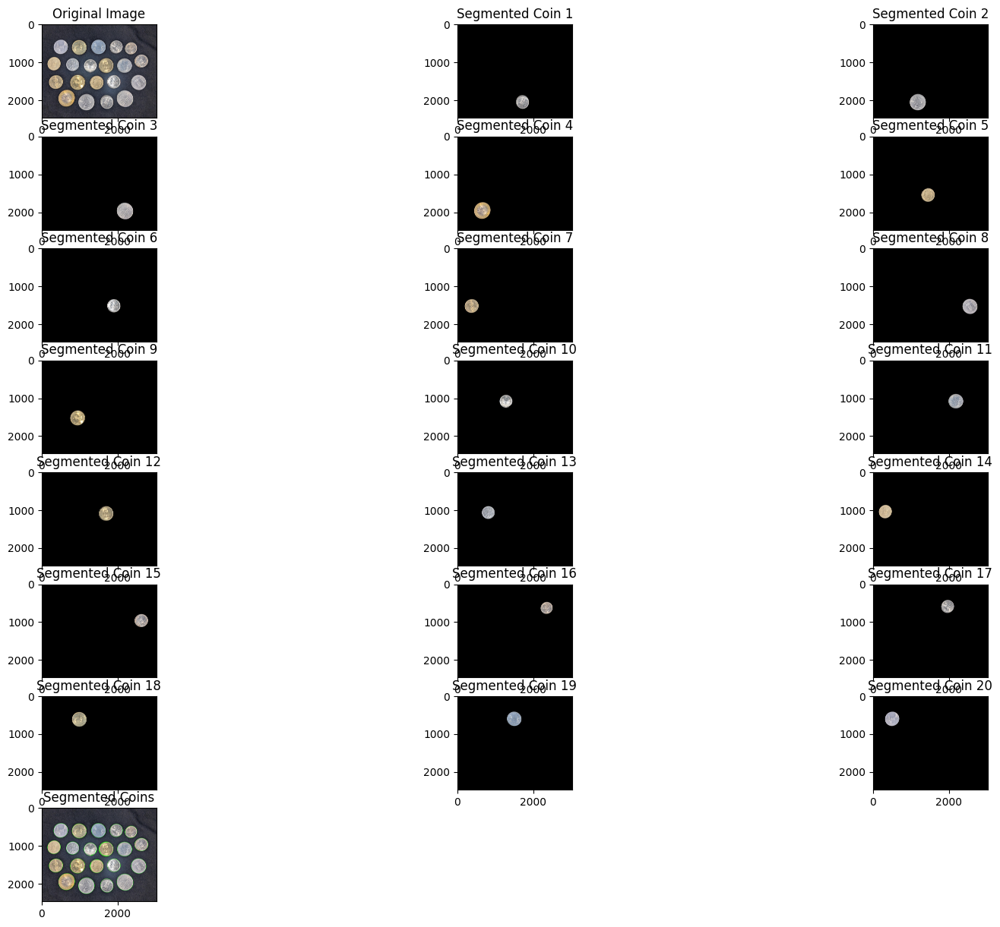

Number of coins: 20
C_001.jpg


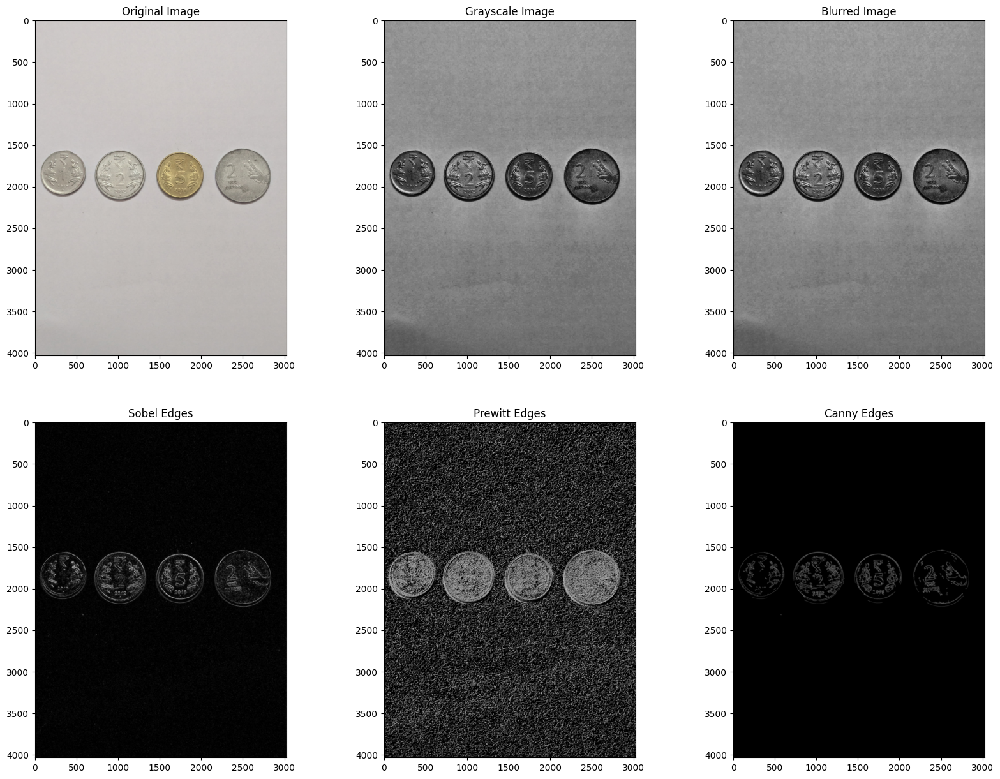

EDGE-BASED SEGMENTATION
Number of contours: 49


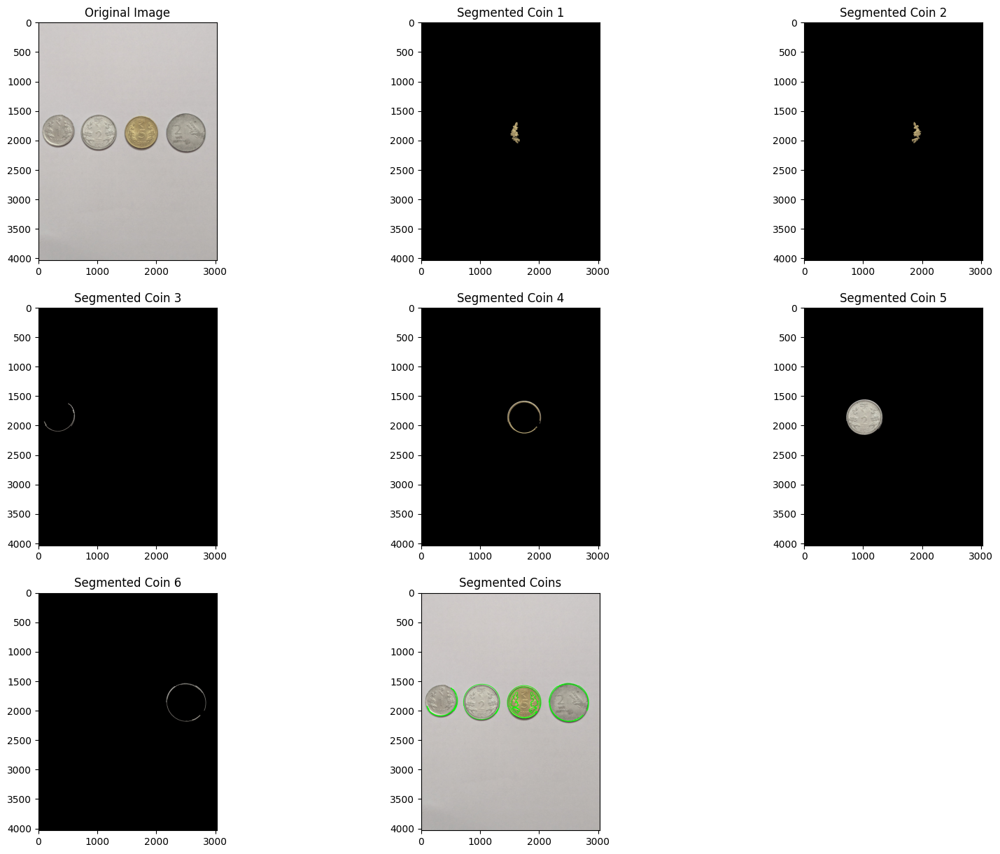

Number of coins: 6
REGION-BASED SEGMENTATION


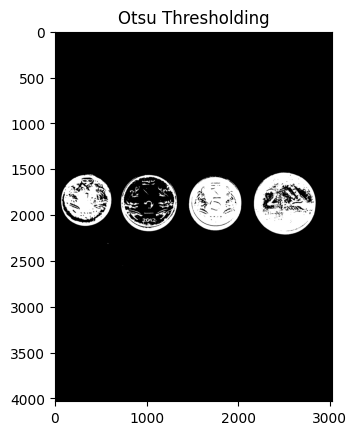

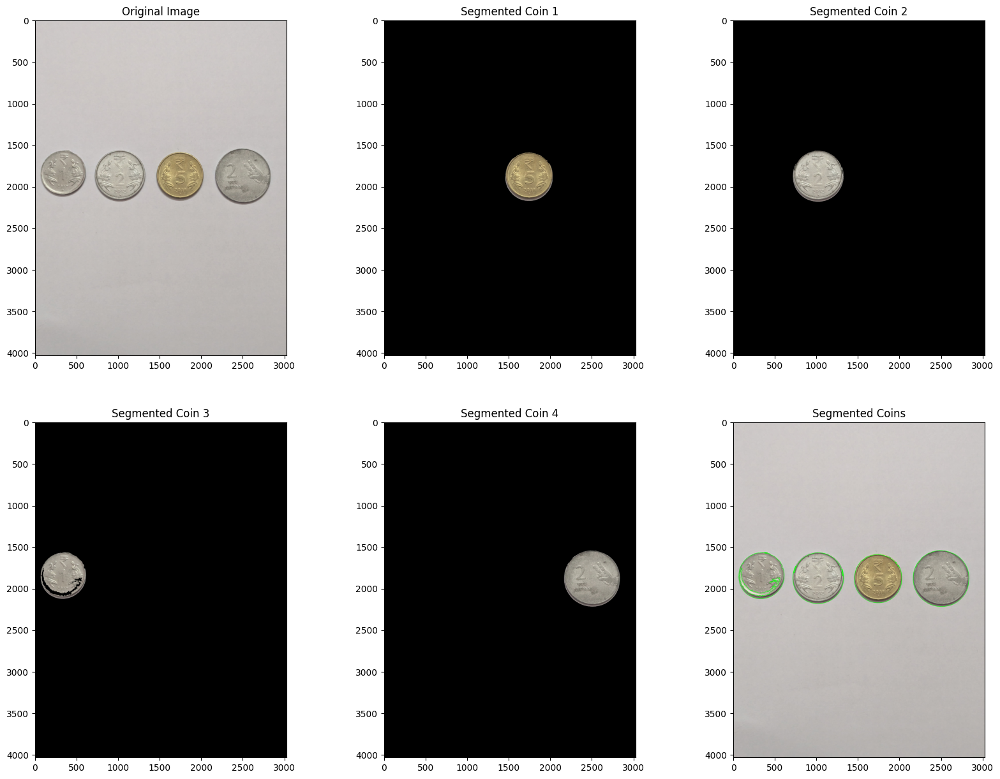

Number of coins: 4
C_1.jpg


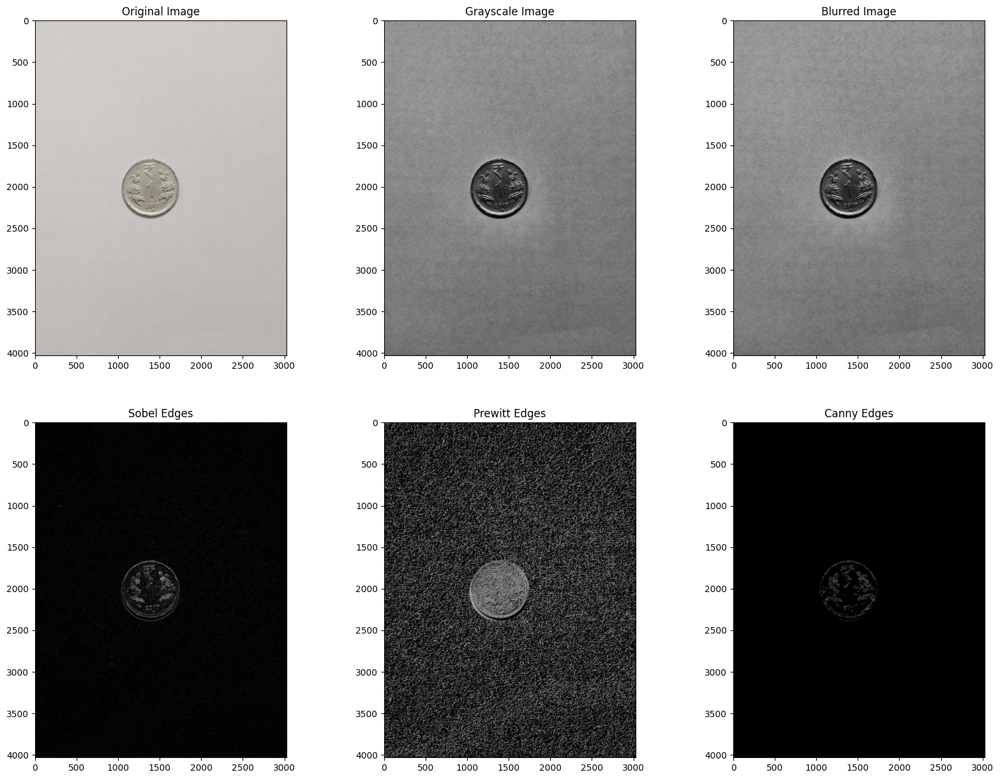

EDGE-BASED SEGMENTATION
Number of contours: 25


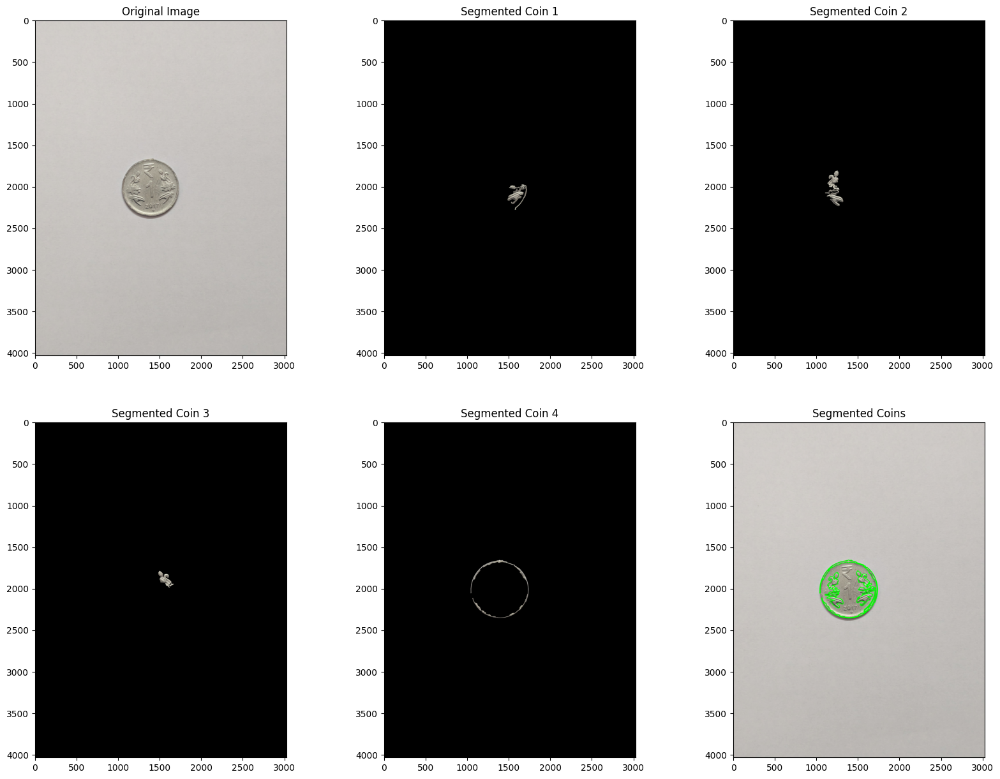

Number of coins: 4
REGION-BASED SEGMENTATION


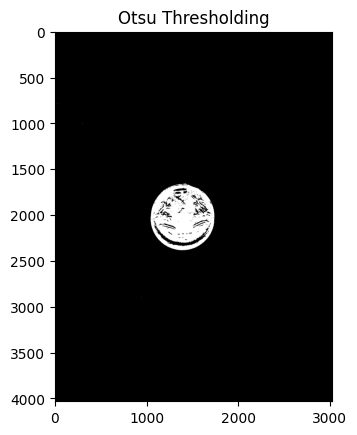

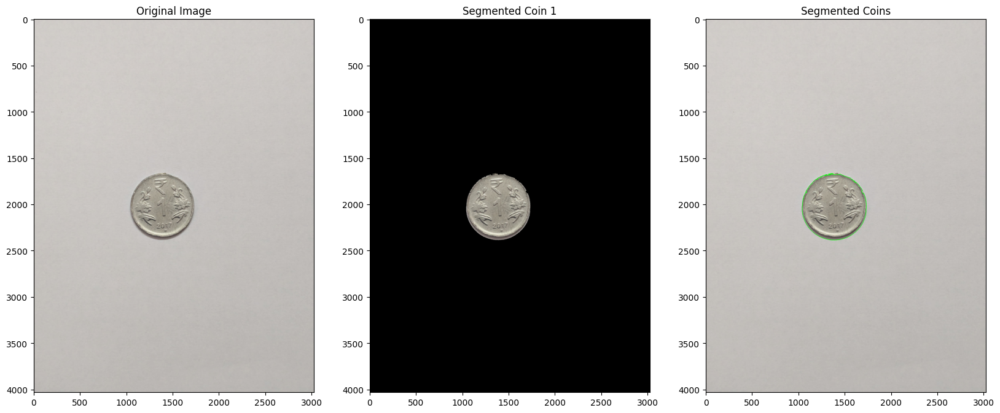

Number of coins: 1
C_10.jpg


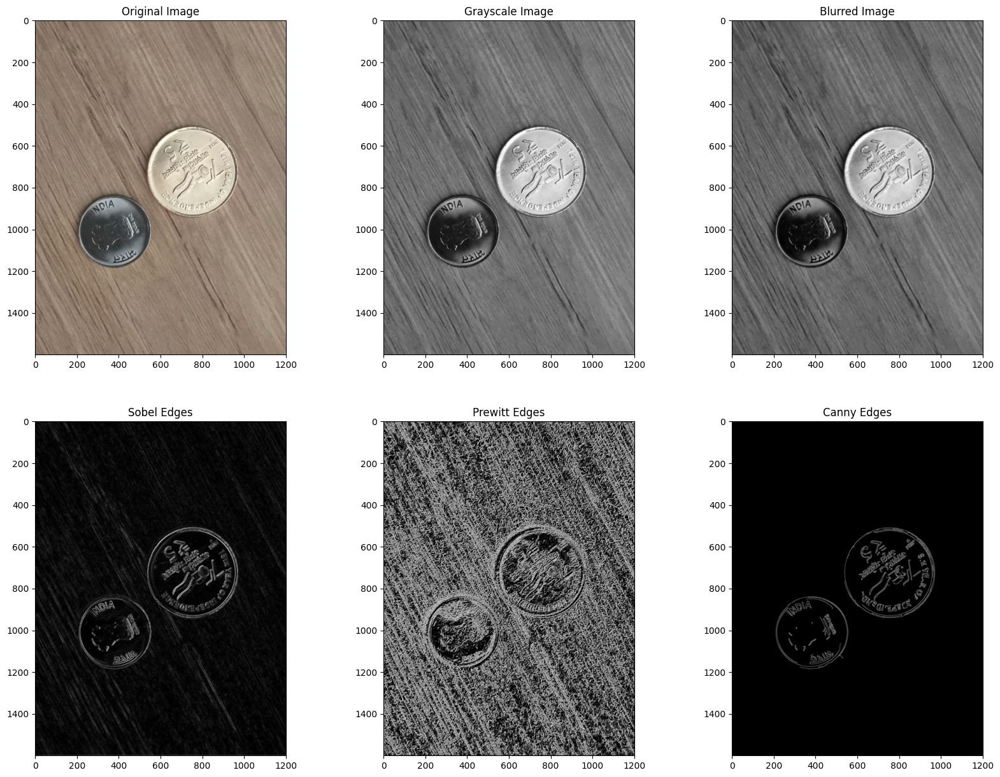

EDGE-BASED SEGMENTATION
Number of contours: 12


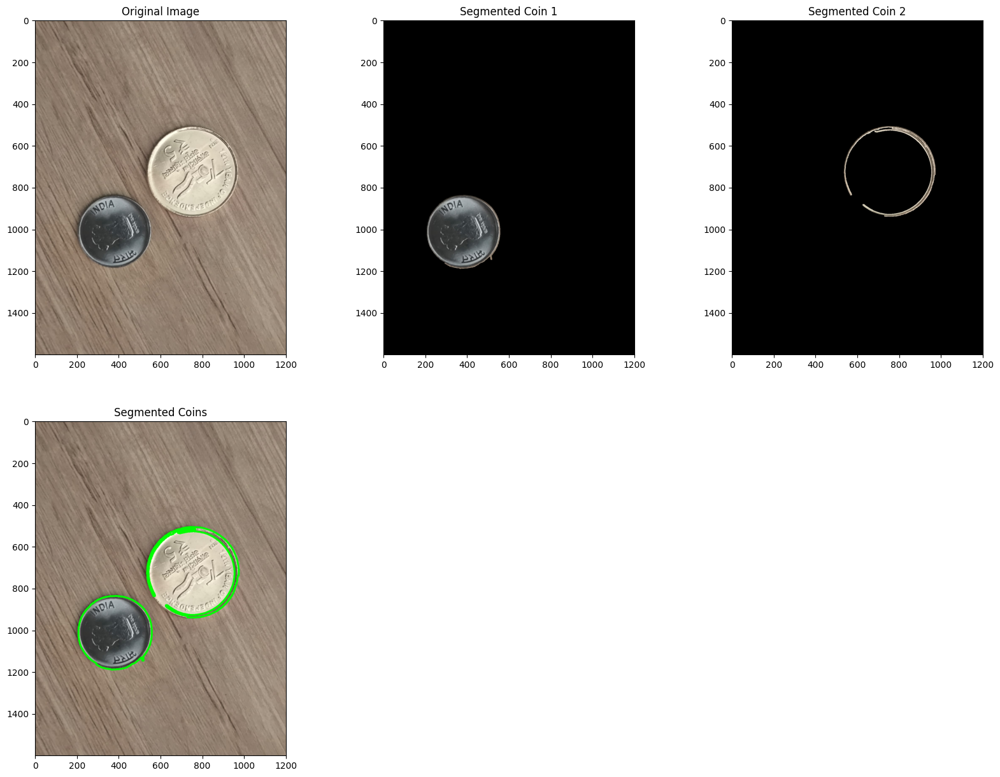

Number of coins: 2
REGION-BASED SEGMENTATION


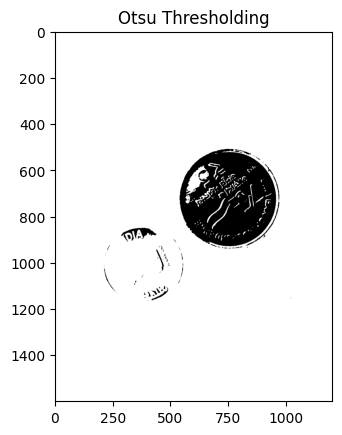

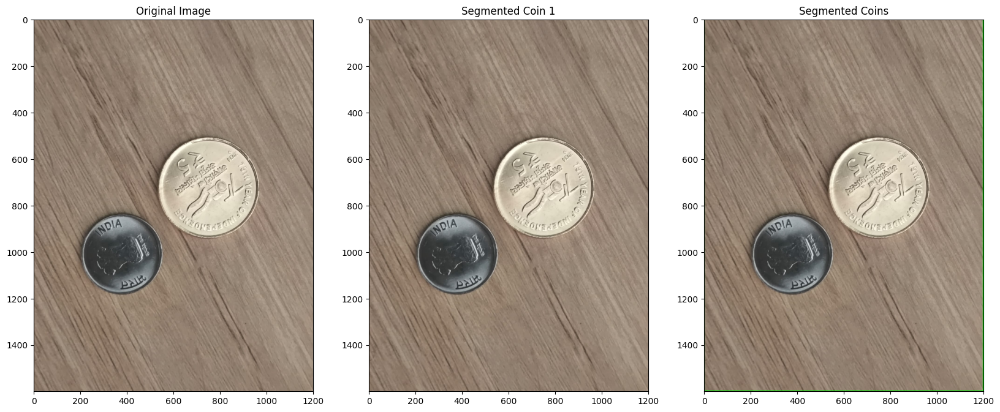

Number of coins: 1
C_11.jpg


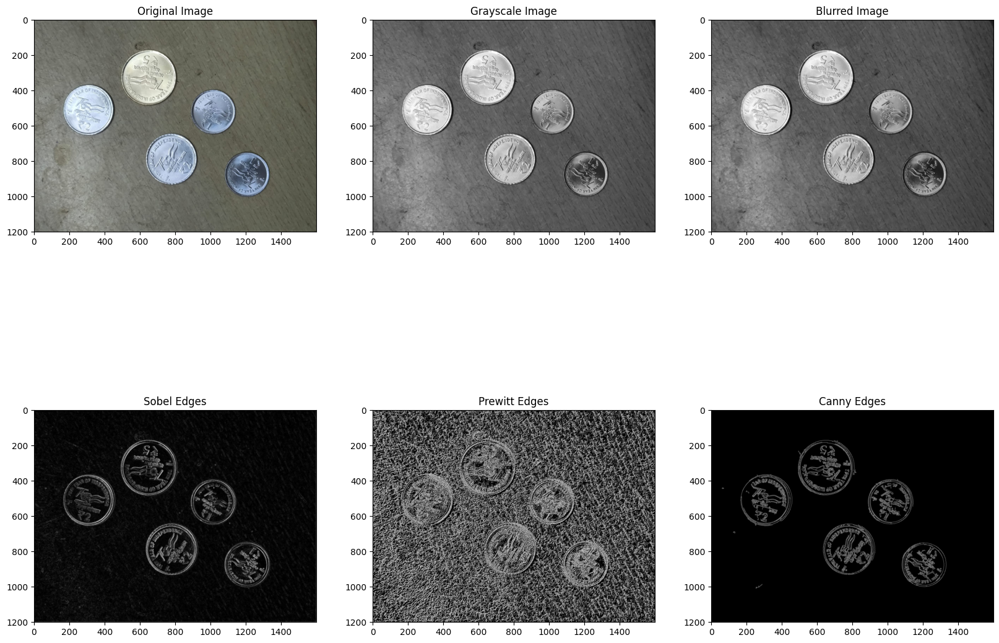

EDGE-BASED SEGMENTATION
Number of contours: 5


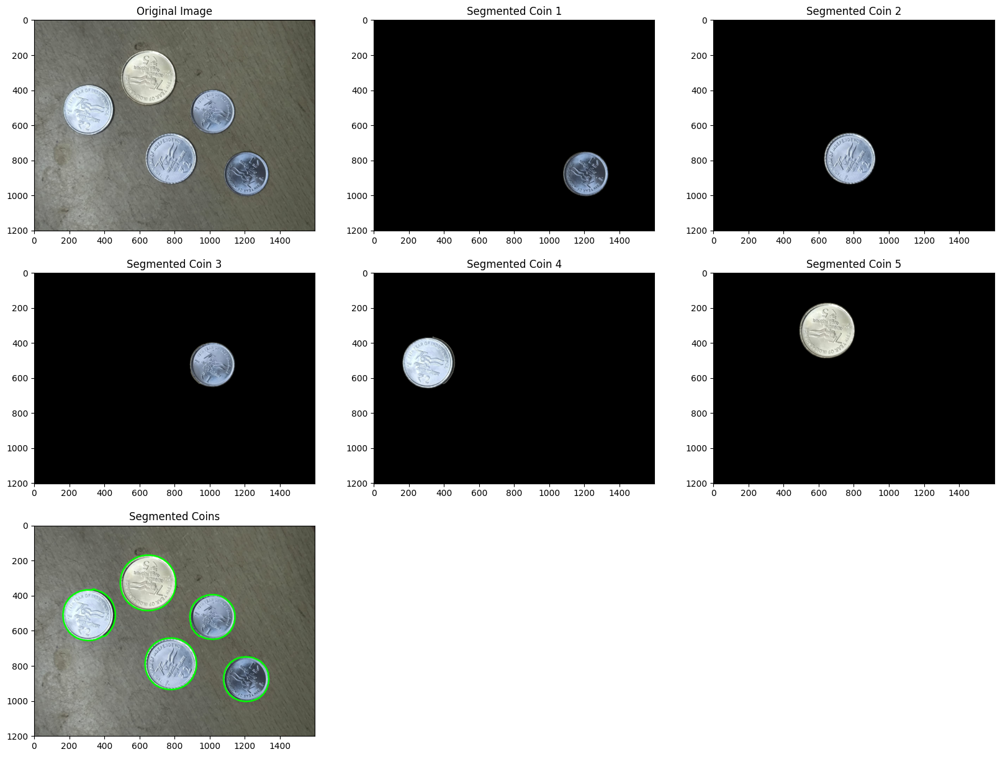

Number of coins: 5
REGION-BASED SEGMENTATION


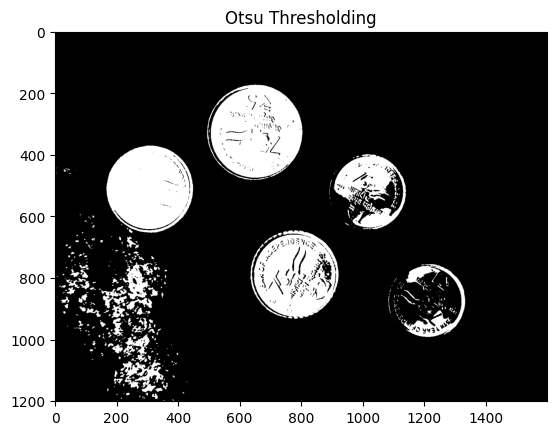

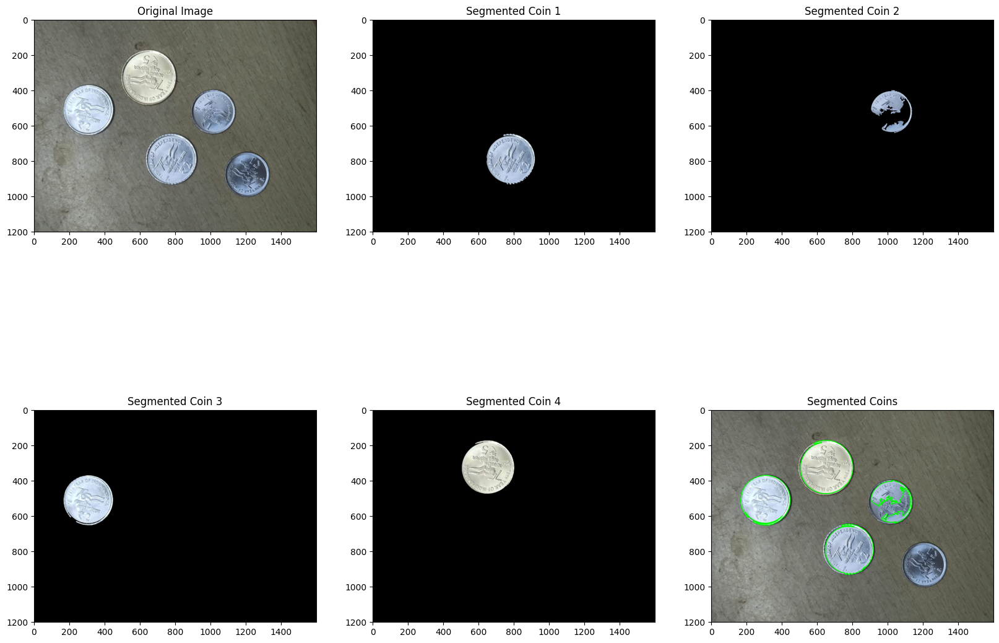

Number of coins: 4
C_2.jpg


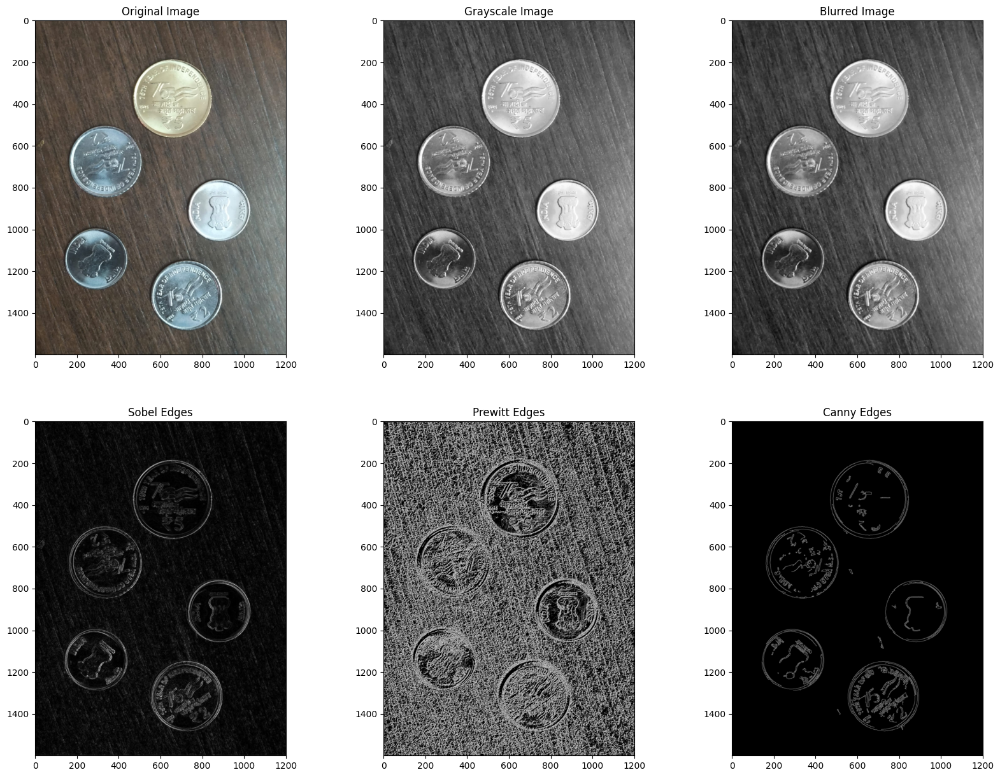

EDGE-BASED SEGMENTATION
Number of contours: 6


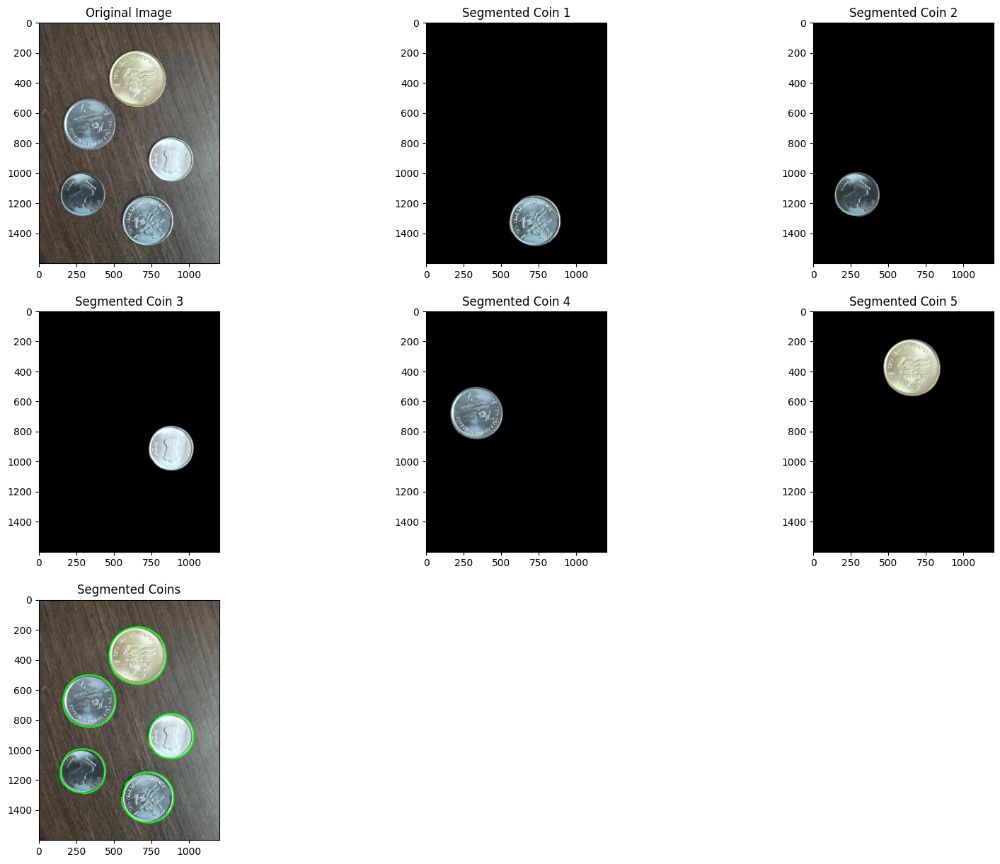

Number of coins: 5
REGION-BASED SEGMENTATION


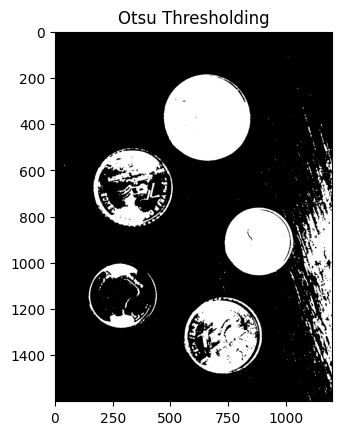

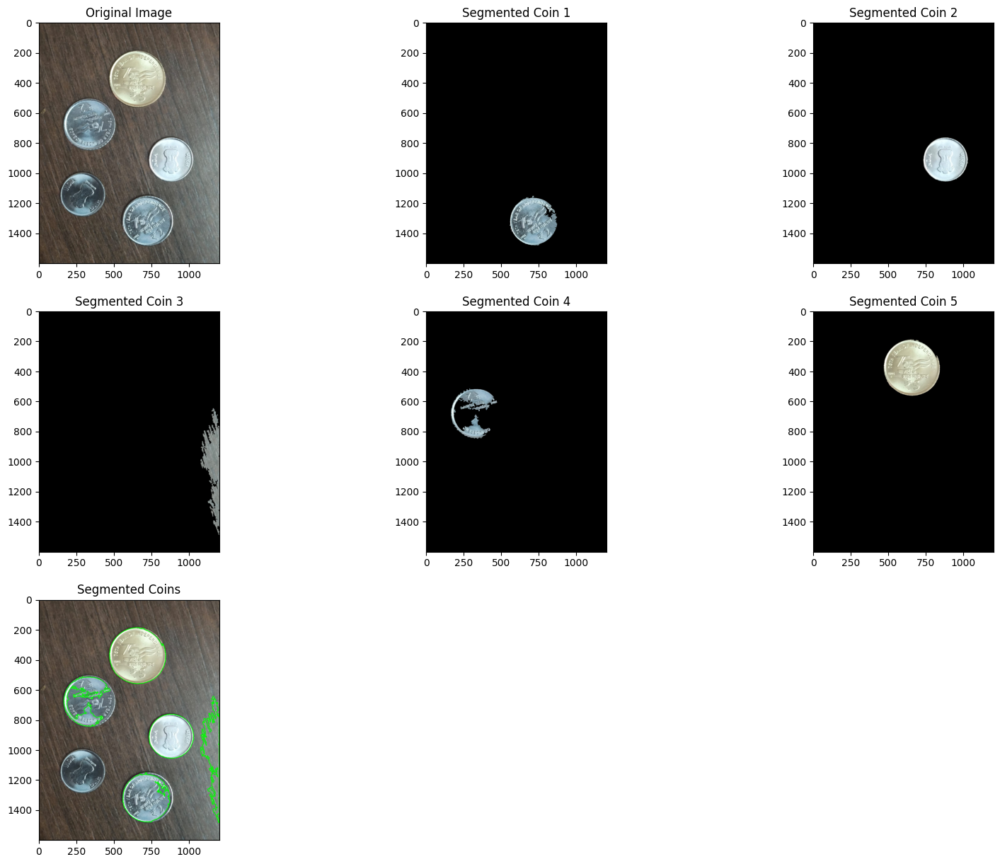

Number of coins: 5
C_3.jpg


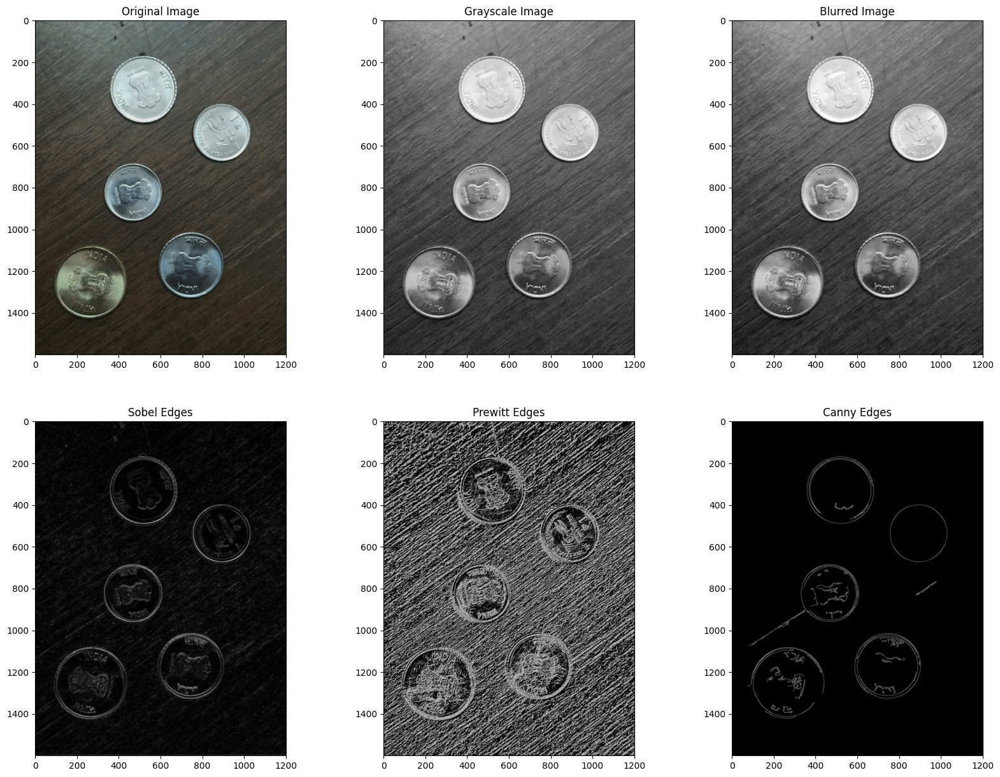

EDGE-BASED SEGMENTATION
Number of contours: 10


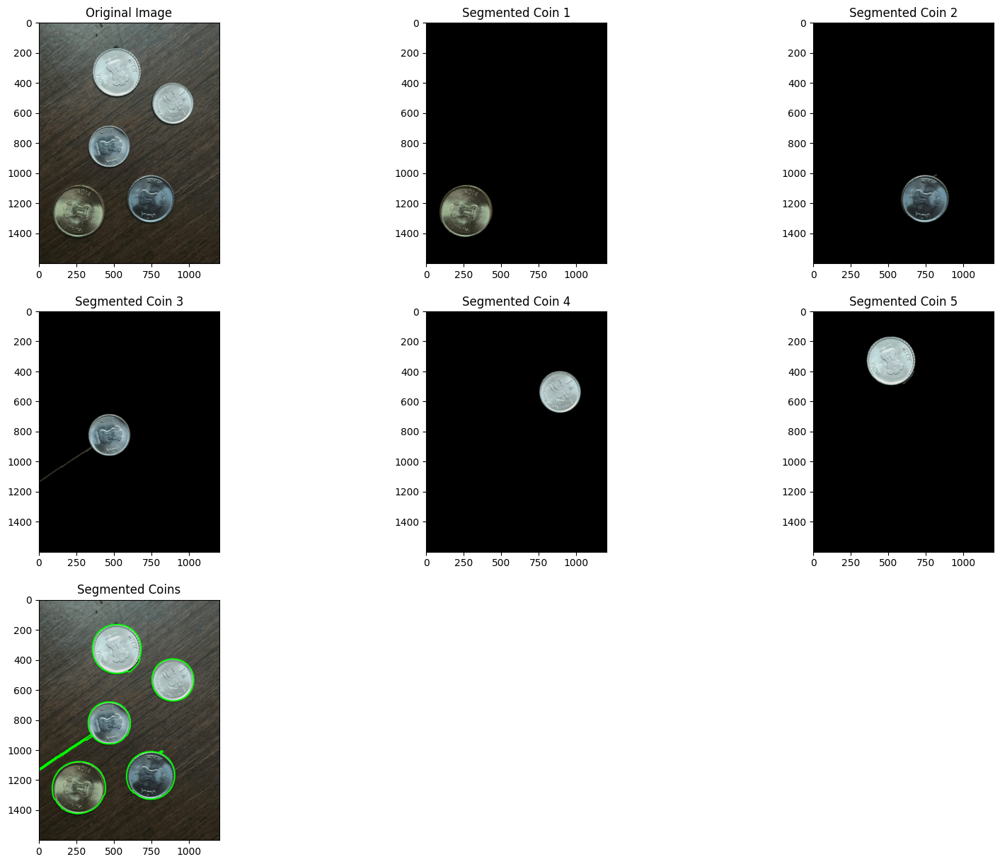

Number of coins: 5
REGION-BASED SEGMENTATION


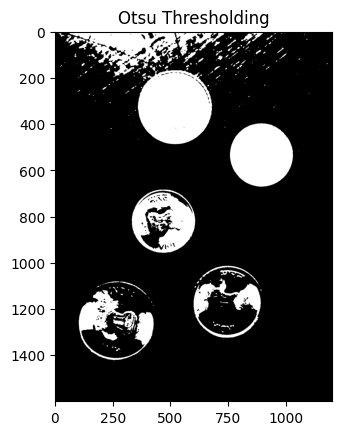

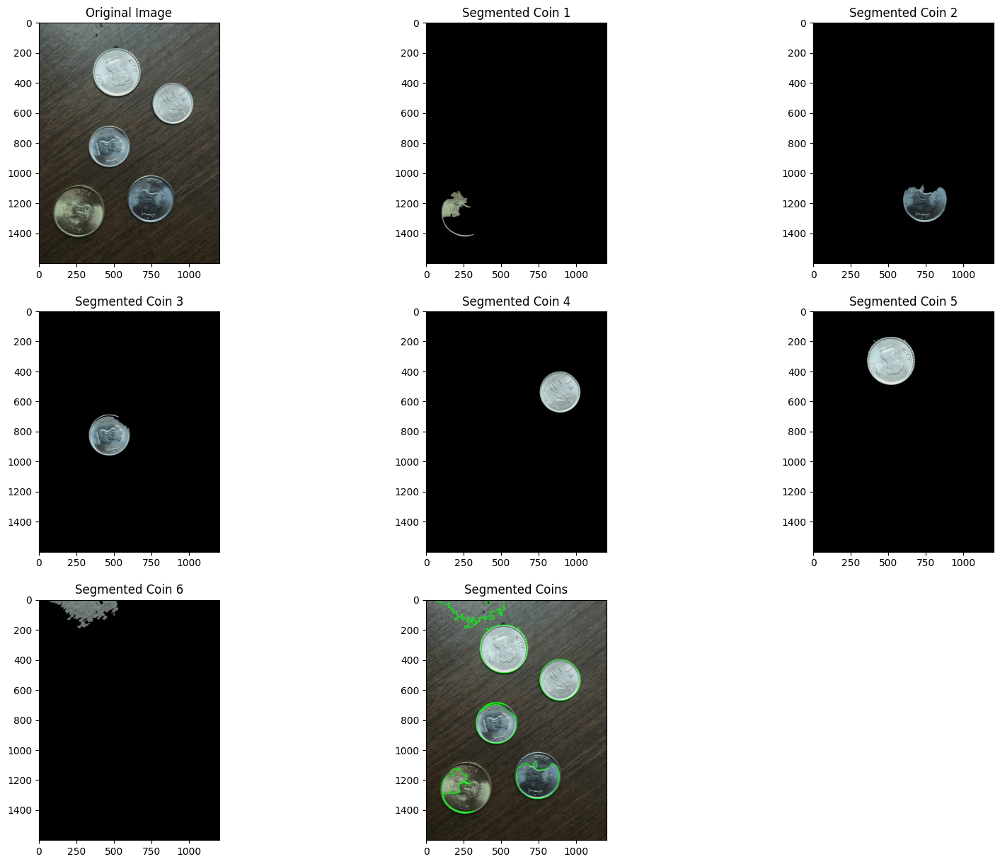

Number of coins: 6
C_4.jpg


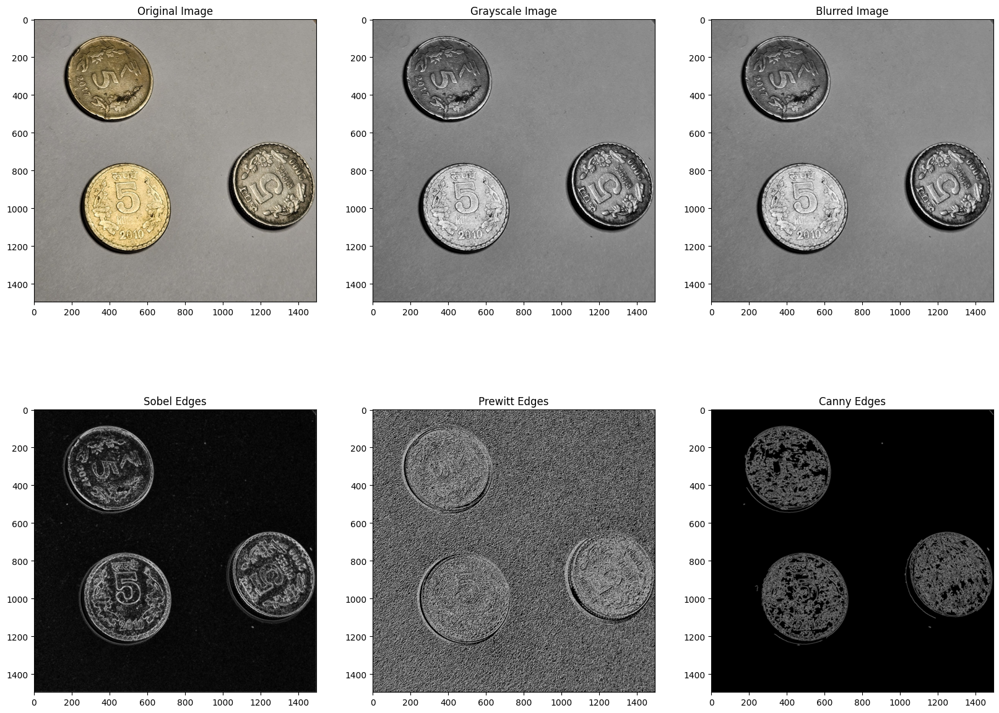

EDGE-BASED SEGMENTATION
Number of contours: 9


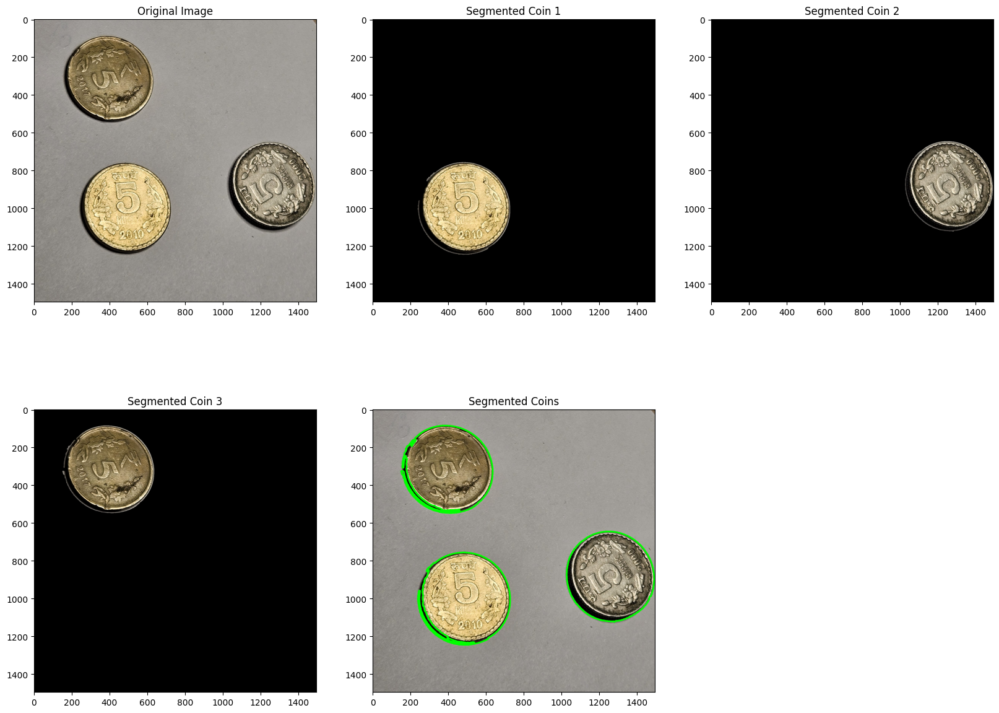

Number of coins: 3
REGION-BASED SEGMENTATION


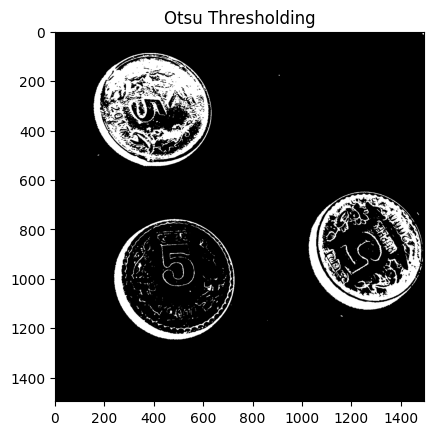

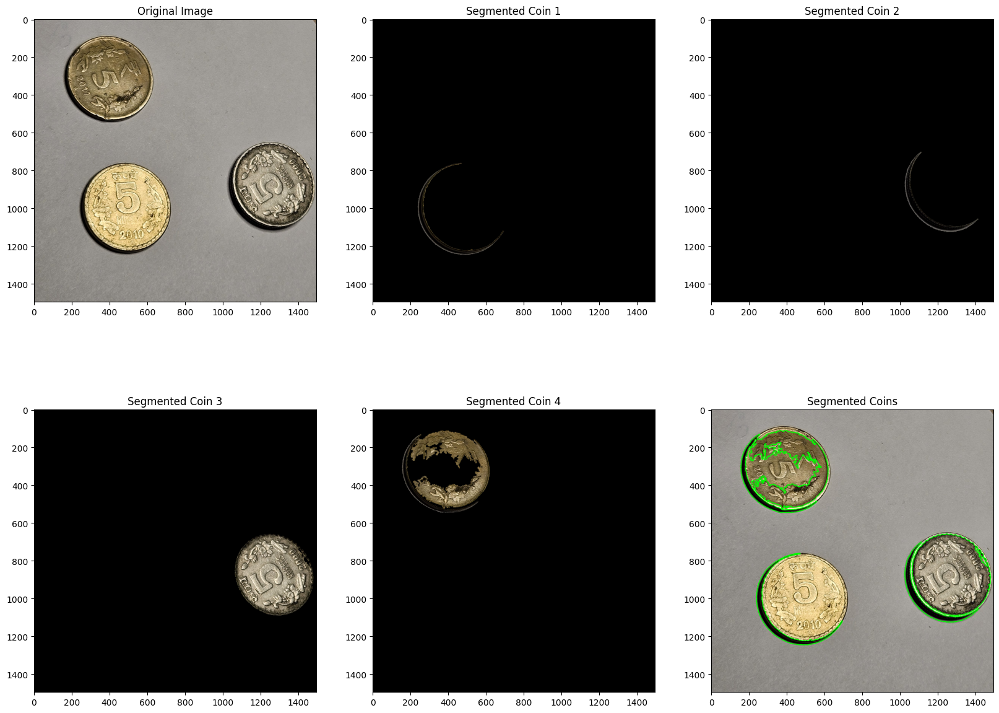

Number of coins: 4
C_5.jpg


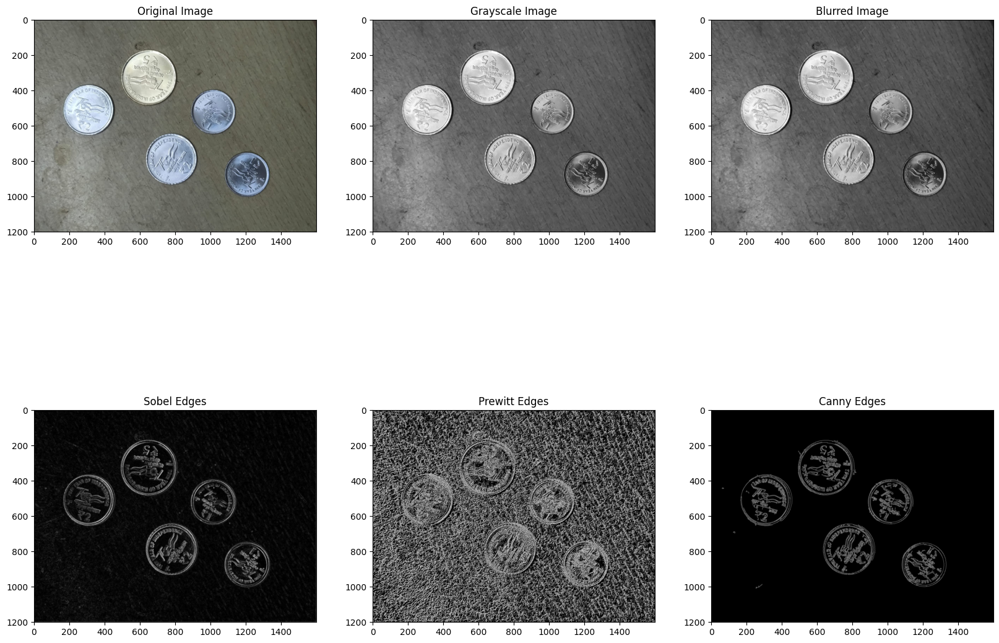

EDGE-BASED SEGMENTATION
Number of contours: 5


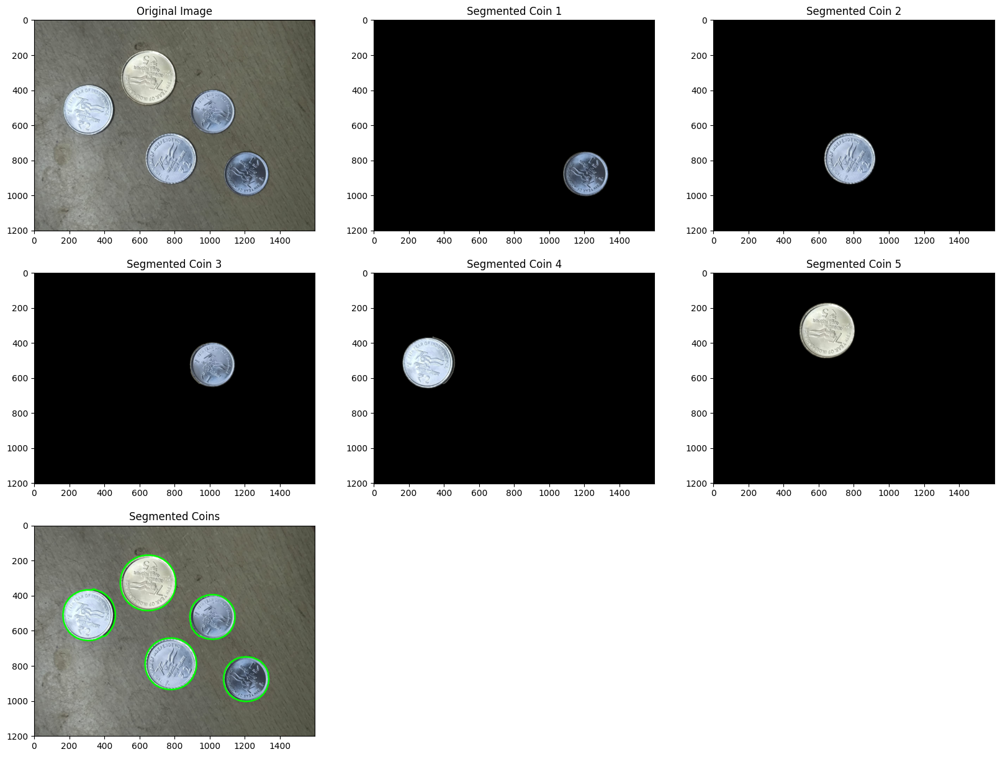

Number of coins: 5
REGION-BASED SEGMENTATION


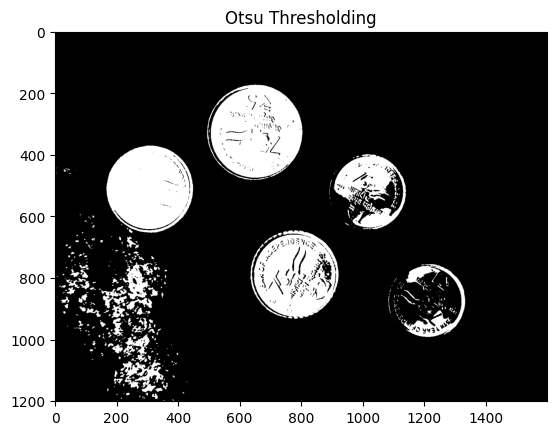

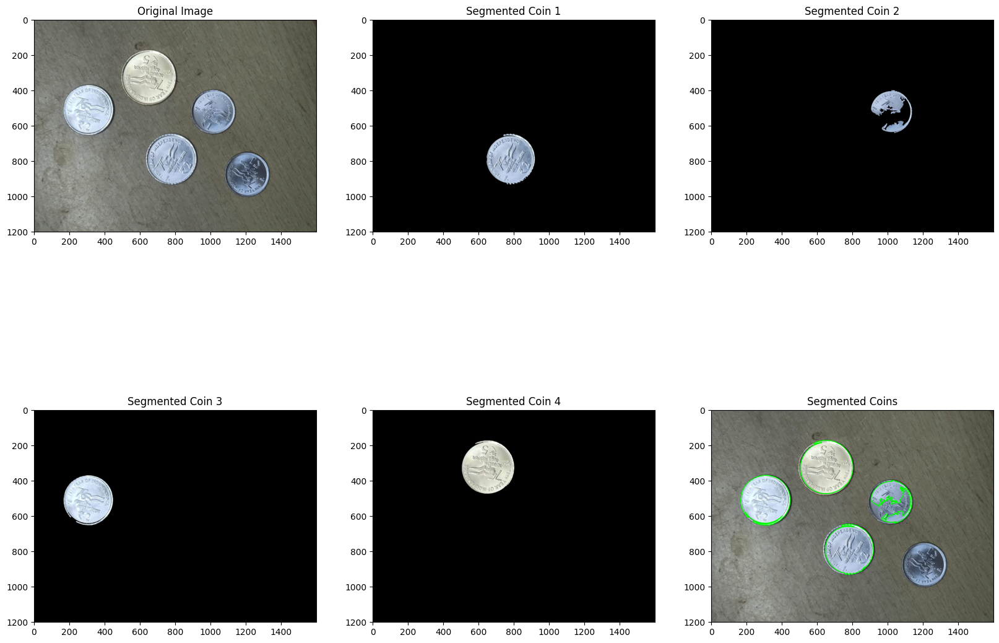

Number of coins: 4
C_6.jpg


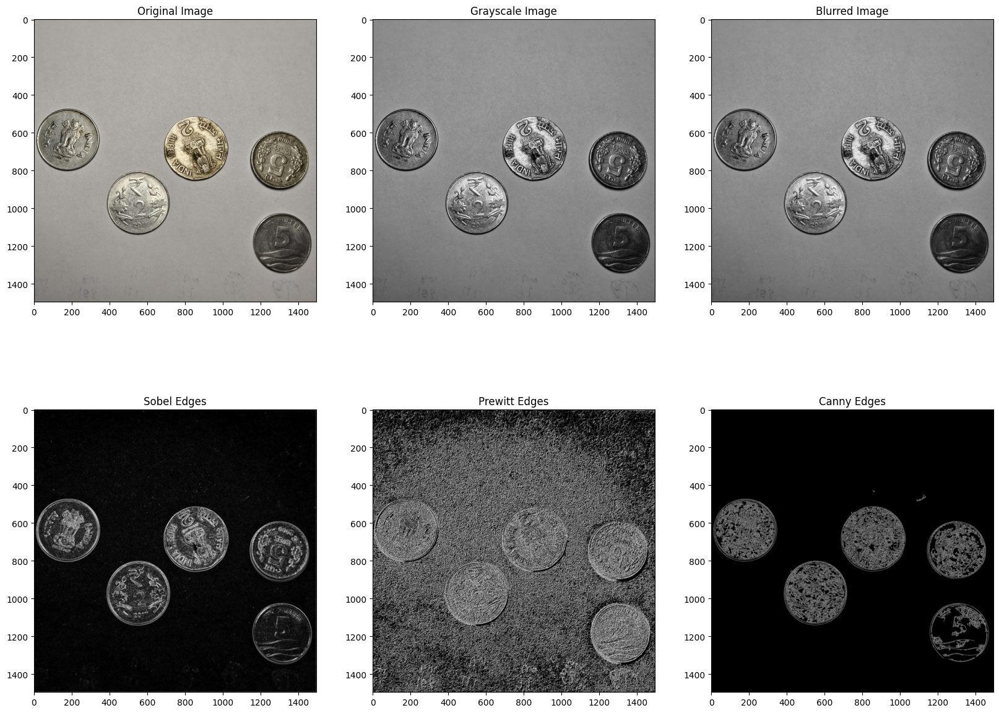

EDGE-BASED SEGMENTATION
Number of contours: 6


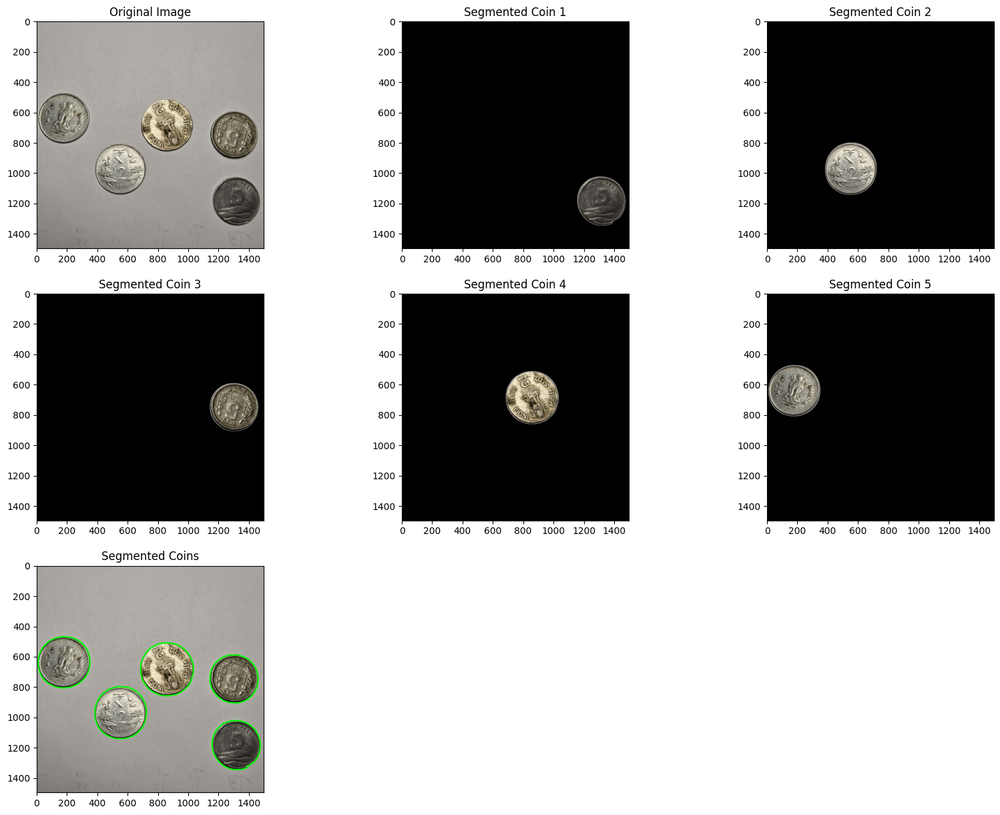

Number of coins: 5
REGION-BASED SEGMENTATION


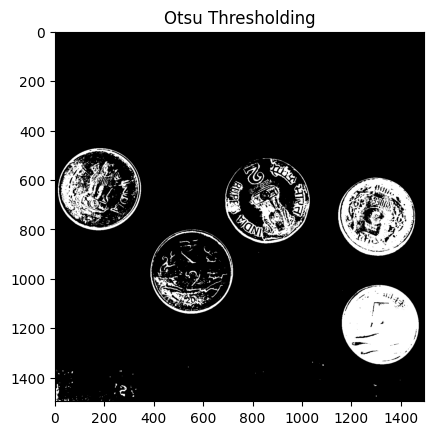

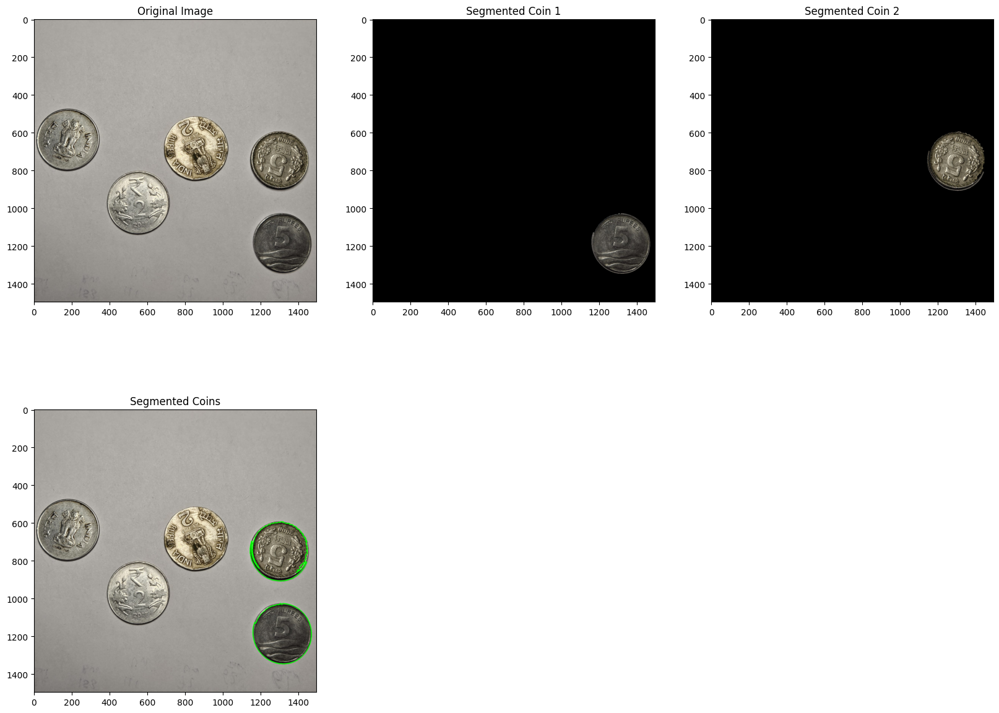

Number of coins: 2
C_7.jpg


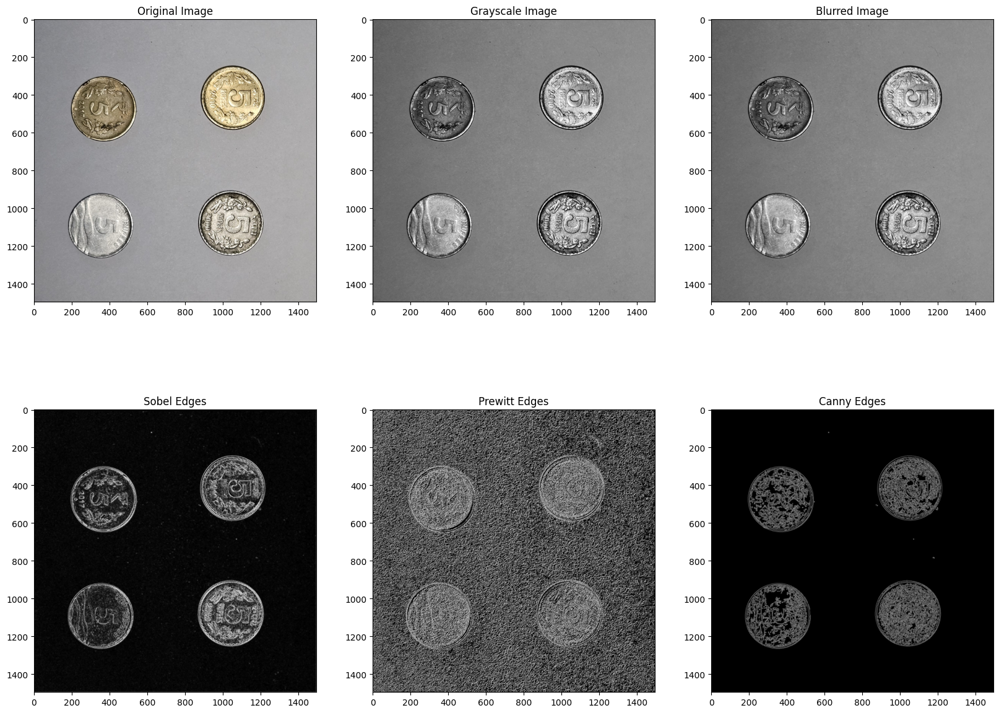

EDGE-BASED SEGMENTATION
Number of contours: 7


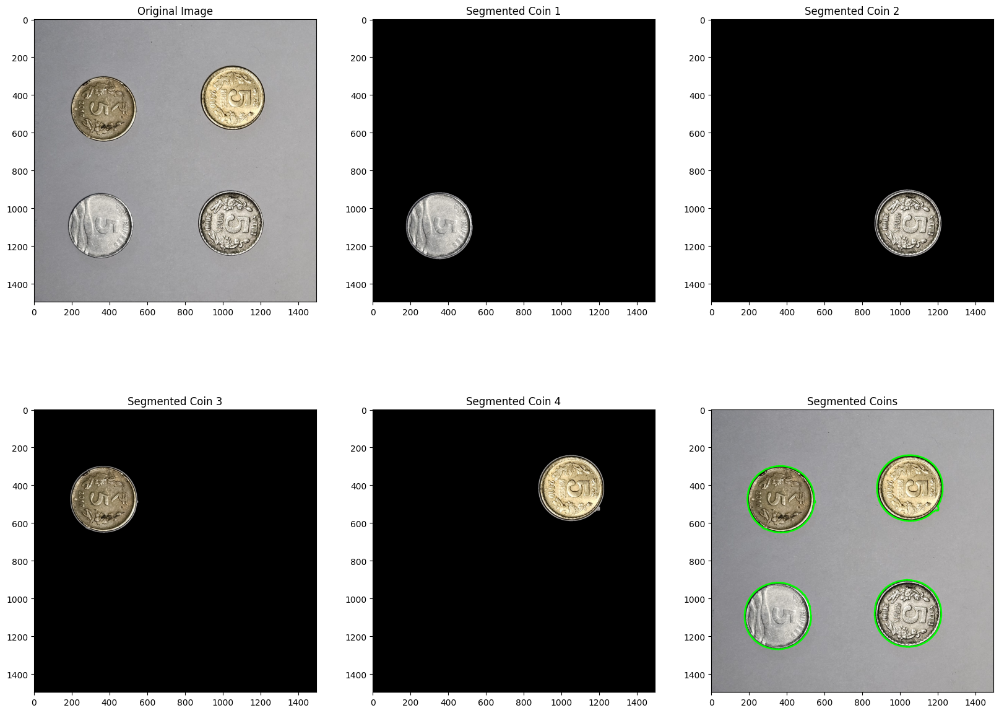

Number of coins: 4
REGION-BASED SEGMENTATION


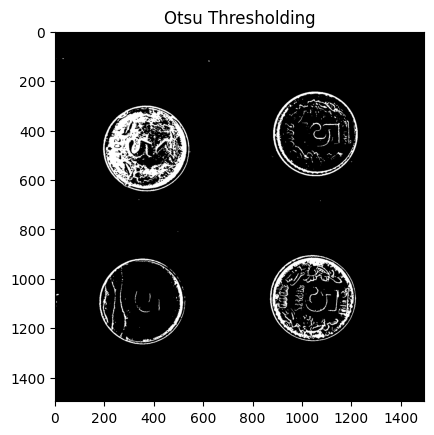

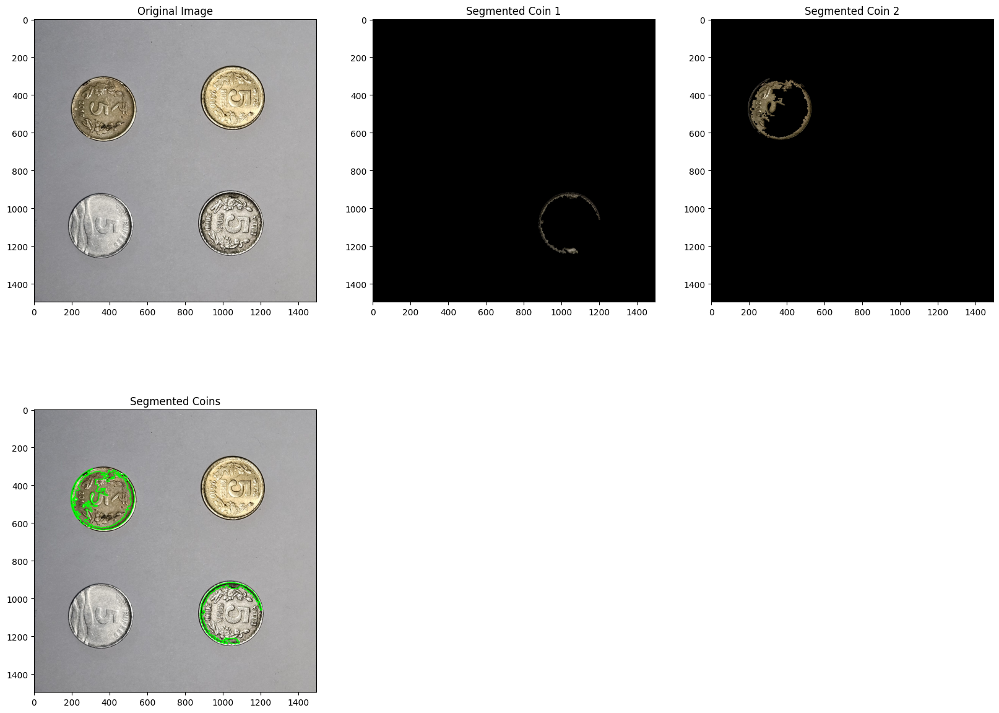

Number of coins: 2
C_8.jpg


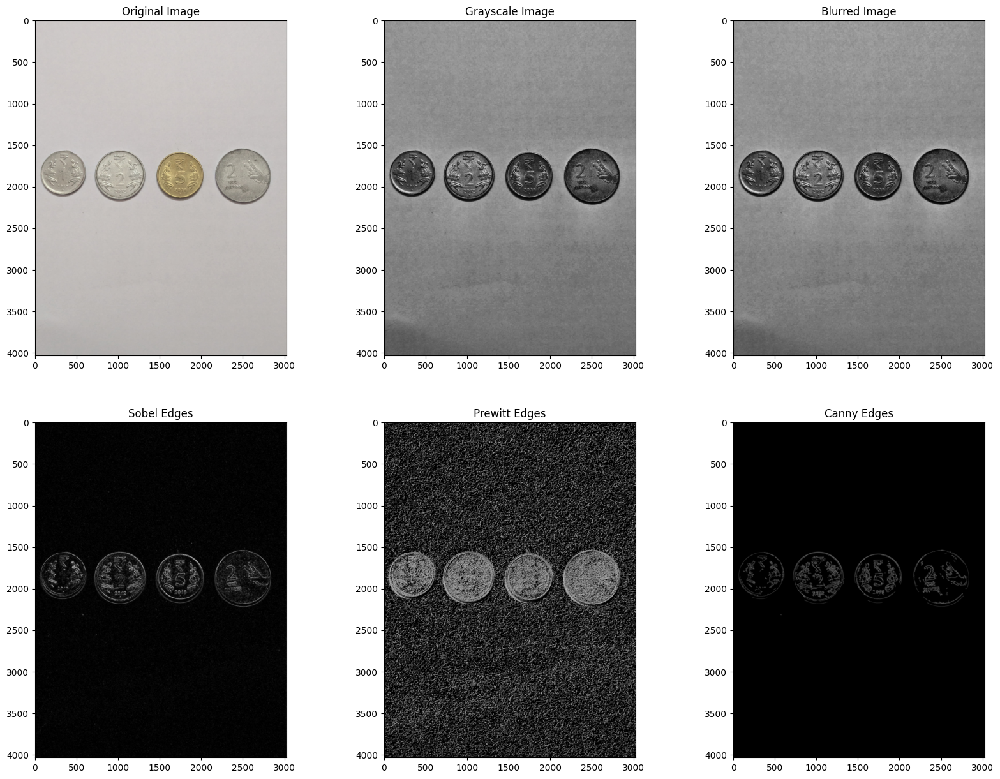

EDGE-BASED SEGMENTATION
Number of contours: 49


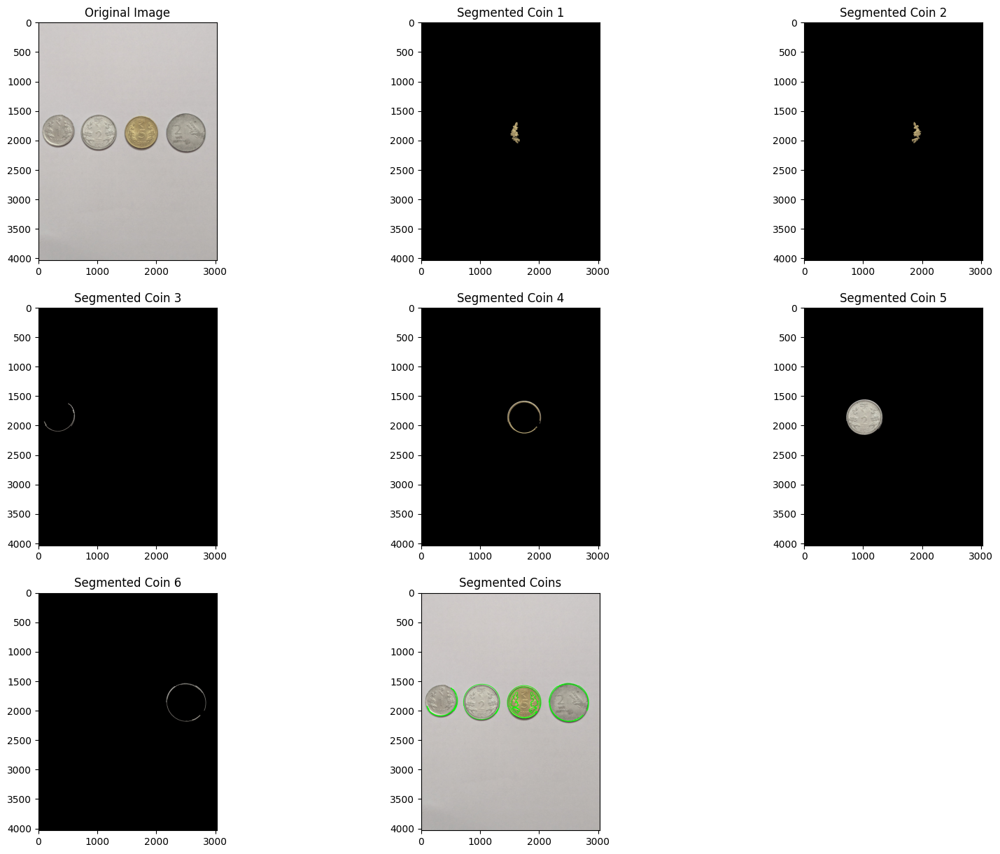

Number of coins: 6
REGION-BASED SEGMENTATION


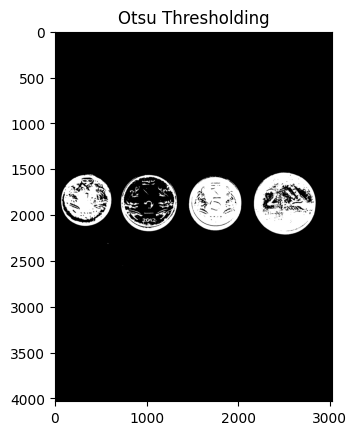

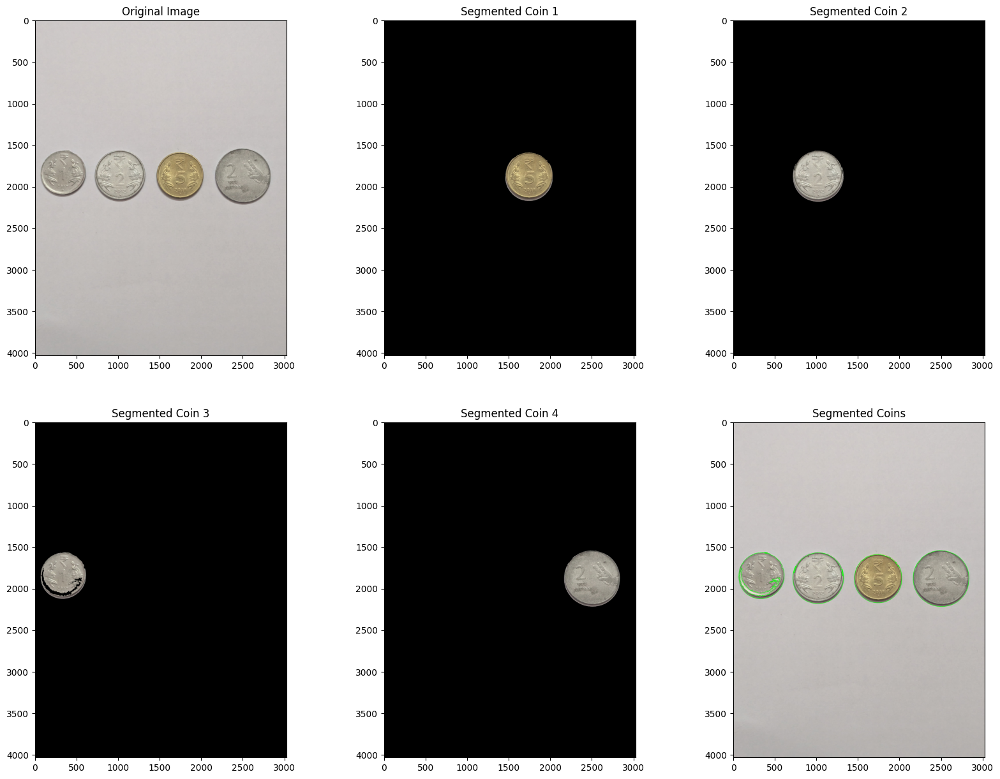

Number of coins: 4
C_9.jpg


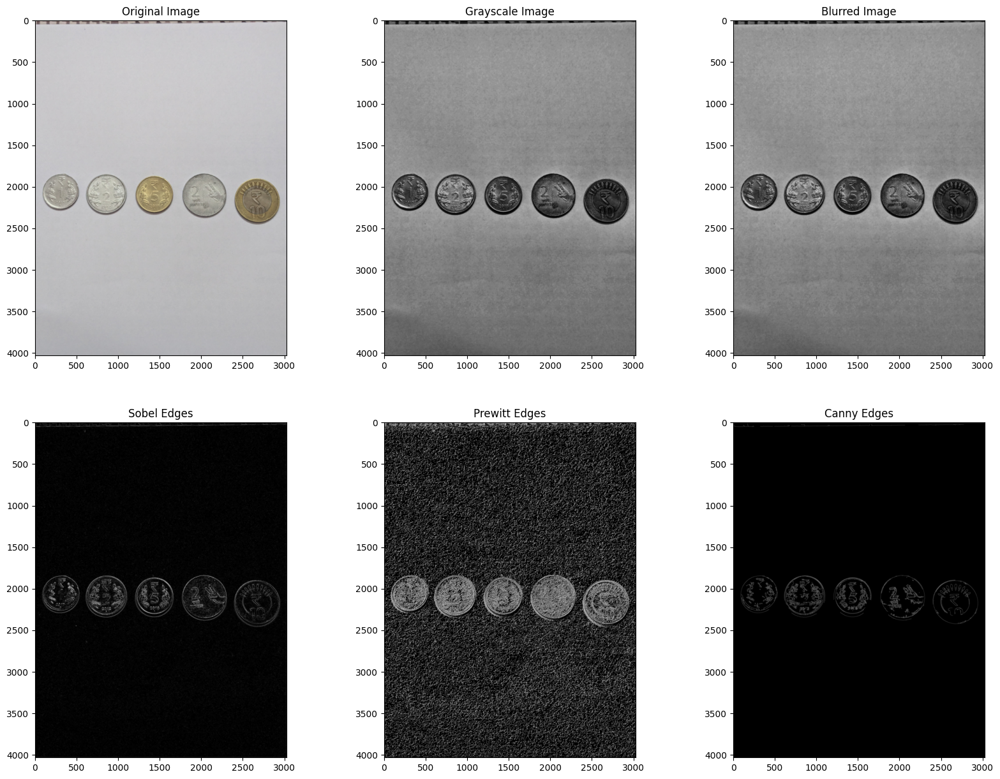

EDGE-BASED SEGMENTATION
Number of contours: 51


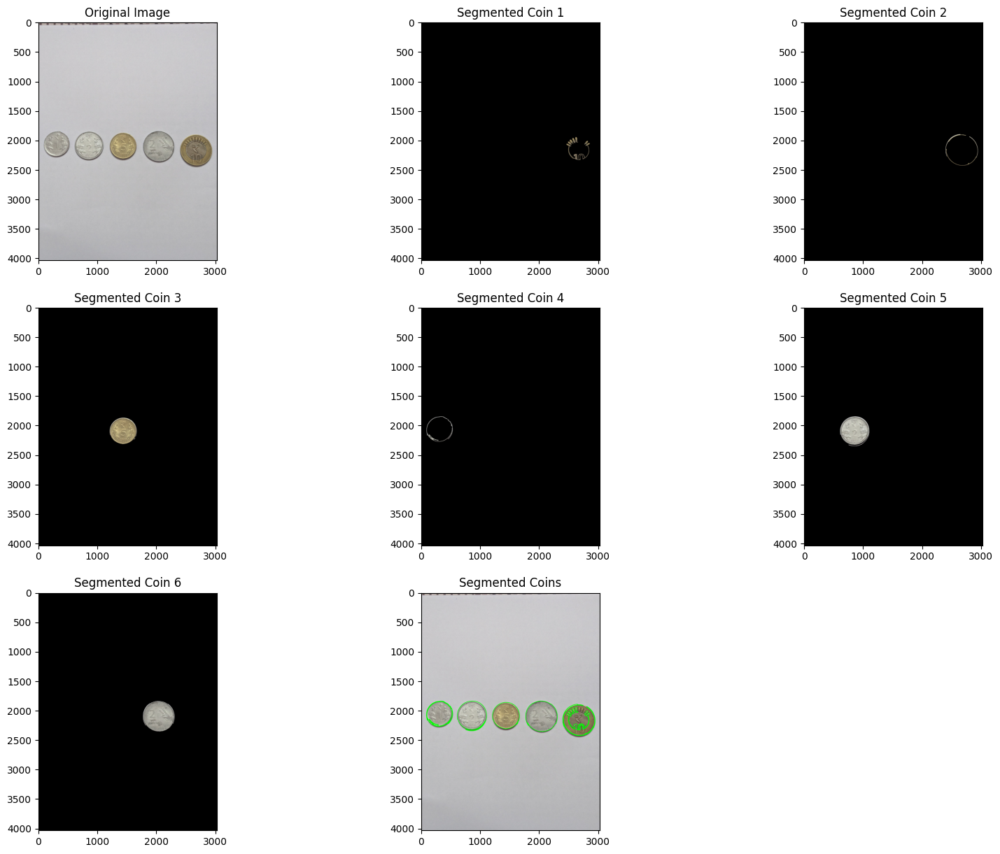

Number of coins: 6
REGION-BASED SEGMENTATION


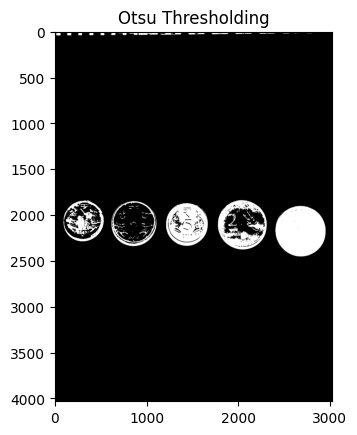

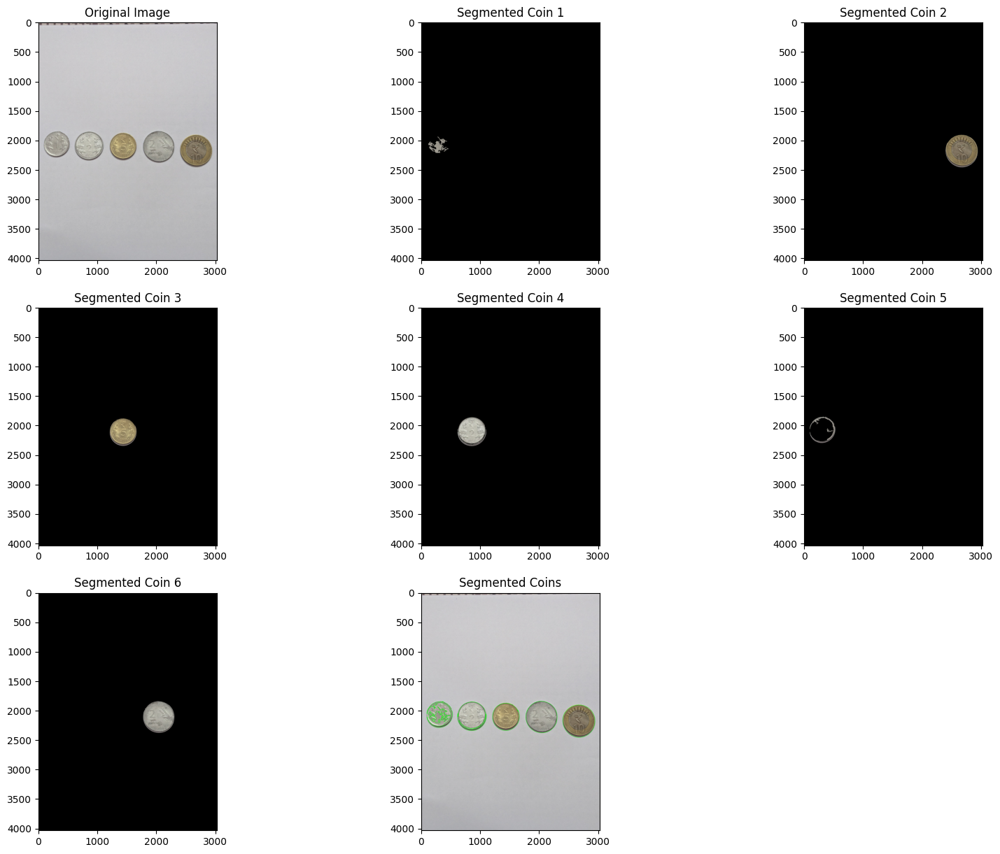

Number of coins: 6


In [29]:
def process_image(image,image_name,segmentation_technique):
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  segmented_coins_all,segmented_coins = segmentation_technique(image)
  count = count_coins(segmented_coins)
  rows = ceil((len(segmented_coins)+2)/3)
  plt.figure(figsize=(20, 15))
  plt.subplot(rows, 3, 1)
  plt.imshow(image)
  plt.title('Original Image')

  for i in range(2,len(segmented_coins)+2):
      plt.subplot(rows, 3, i)
      plt.imshow(segmented_coins[i-2])
      plt.title(f'Segmented Coin {i-1}')

  plt.subplot(rows, 3,len(segmented_coins)+2)
  plt.imshow(segmented_coins_all)
  plt.title('Segmented Coins')
  plt.savefig(f'{RESULT_DIR}{image_name}_segmentation.png')
  plt.show()

  print(f"Number of coins: {count}")



directory_path = Path(DATASET_DIR)

for img_file in sorted([f.name for f in directory_path.iterdir() if f.is_file()]):
  print(img_file)
  image = cv2.imread(f"{DATASET_DIR}{img_file}")
  process_edges(image,img_file.split('.')[0])
  print("EDGE-BASED SEGMENTATION")
  process_image(image,f"{img_file.split('.')[0]}_edge_based",segment_coins_contours)
  print("REGION-BASED SEGMENTATION")
  process_image(image,f"{img_file.split('.')[0]}_region_based", segment_coins_otsu)


